In [0]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
%matplotlib inline

In [0]:
import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data_utils


import torchvision
from torchvision import transforms
from PIL import Image

In [3]:
from google.colab import drive
drive.mount('/content/gdrive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive/


In [9]:
!unzip -qq /content/gdrive/My\ Drive/kana.zip 
!ls

kana/train_data/あ/:  mismatching "local" filename (kana/train_data/уБВ/),
         continuing with "central" filename version
kana/train_data/あ/1900_761460_0029.png:  mismatching "local" filename (kana/train_data/уБВ/1900_761460_0029.png),
         continuing with "central" filename version
kana/train_data/あ/1902_761070_0102.png:  mismatching "local" filename (kana/train_data/уБВ/1902_761070_0102.png),
         continuing with "central" filename version
kana/train_data/あ/1903_824818_0061.png:  mismatching "local" filename (kana/train_data/уБВ/1903_824818_0061.png),
         continuing with "central" filename version
kana/train_data/あ/1908_776597_0157.png:  mismatching "local" filename (kana/train_data/уБВ/1908_776597_0157.png),
         continuing with "central" filename version
kana/train_data/あ/1908_793066_0093.png:  mismatching "local" filename (kana/train_data/уБВ/1908_793066_0093.png),
         continuing with "central" filename version
kana/train_data/あ/1908_809495_0083.png:  mis

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



kana/train_data/ロ/db-45a09cd.png:  mismatching "local" filename (kana/train_data/уГн/db-45a09cd.png),
         continuing with "central" filename version
kana/train_data/ロ/db-45b09ce.png:  mismatching "local" filename (kana/train_data/уГн/db-45b09ce.png),
         continuing with "central" filename version
kana/train_data/ロ/db-45c09cf.png:  mismatching "local" filename (kana/train_data/уГн/db-45c09cf.png),
         continuing with "central" filename version
kana/train_data/ロ/db-45d09d0.png:  mismatching "local" filename (kana/train_data/уГн/db-45d09d0.png),
         continuing with "central" filename version
kana/train_data/ロ/db-45e09d1.png:  mismatching "local" filename (kana/train_data/уГн/db-45e09d1.png),
         continuing with "central" filename version
kana/train_data/ロ/db-45f09d2.png:  mismatching "local" filename (kana/train_data/уГн/db-45f09d2.png),
         continuing with "central" filename version
kana/train_data/ロ/db-46009d3.png:  mismatching "local" filename (kana/train_

In [0]:
classes = os.listdir("kana/train_data")

In [11]:
n_classes = len(classes)
classes = sorted(classes)
classes

['あ',
 'い',
 'う',
 'え',
 'お',
 'か',
 'き',
 'く',
 'け',
 'こ',
 'さ',
 'し',
 'す',
 'せ',
 'そ',
 'た',
 'ち',
 'つ',
 'て',
 'と',
 'な',
 'に',
 'ぬ',
 'ね',
 'の',
 'は',
 'ひ',
 'ふ',
 'へ',
 'ほ',
 'ま',
 'み',
 'む',
 'め',
 'も',
 'や',
 'ゆ',
 'よ',
 'ら',
 'り',
 'る',
 'れ',
 'ろ',
 'わ',
 'を',
 'ん',
 'ア',
 'イ',
 'ウ',
 'エ',
 'オ',
 'カ',
 'キ',
 'ク',
 'ケ',
 'コ',
 'サ',
 'シ',
 'ス',
 'セ',
 'ソ',
 'タ',
 'チ',
 'ツ',
 'テ',
 'ト',
 'ナ',
 'ニ',
 'ヌ',
 'ネ',
 'ノ',
 'ハ',
 'ヒ',
 'フ',
 'ヘ',
 'ホ',
 'マ',
 'ミ',
 'ム',
 'メ',
 'モ',
 'ヤ',
 'ユ',
 'ヨ',
 'ラ',
 'リ',
 'ル',
 'レ',
 'ロ',
 'ワ',
 'ヲ',
 'ン']

In [0]:
fin = open('classes.txt', 'w', encoding='utf-8')
fin.write(' '.join(classes))
fin.close()

In [0]:
IMG_H = 28
IMG_W = 28

batch_size = 64

In [0]:
transform = {
    'train': transforms.Compose([
        transforms.Grayscale(num_output_channels=1),
        transforms.Resize((IMG_H, IMG_W)),
        
        transforms.RandomApply([
            transforms.RandomRotation(15),            
            transforms.ColorJitter(contrast=0.3, saturation=0.3)
        ], p=0.2),
        
        transforms.ToTensor(),
    ]),
    'val': transforms.Compose([
        transforms.Grayscale(num_output_channels=1),
        transforms.Resize((IMG_H, IMG_W)),
        transforms.ToTensor(),
        
    ]),
}

In [0]:
train_data = torchvision.datasets.ImageFolder('kana/train_data', transform=transform['train'])
train_loader = data_utils.DataLoader(train_data, batch_size=batch_size, shuffle=True)

val_data = torchvision.datasets.ImageFolder('kana/val_data', transform=transform['val'])
val_loader = data_utils.DataLoader(val_data, batch_size=batch_size, shuffle=False)

し タ を ネ レ ニ ル め


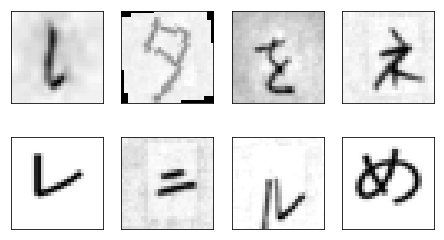

In [16]:
def plot_gallery(images, labels, h, w, n_row=2, n_col=4):
    plt.figure(figsize=(1.5 * n_col, 1.7 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        #plt.title(labels[i])
        plt.imshow(images[i].numpy().reshape((IMG_H, IMG_W)), cmap=plt.cm.gray)
        plt.xticks(())
        plt.yticks(())

dataiter = iter(train_loader)
images, labels = dataiter.next()

plot_gallery(images, [classes[labels[j]] for j in range(len(images))], IMG_H, IMG_W)

print(' '.join(classes[labels[j]] for j in range(8)))

In [17]:
len(train_loader)

1869

In [18]:
len(train_loader.dataset)

119600

In [19]:
n_classes

92

In [0]:
class Model(nn.Module):
    def __init__(self):
        super(Model, self).__init__()  
        self.conv1 = nn.Sequential(
            nn.Conv2d(1, 64, 5),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(64, 128, 5),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        ) 
        self.fc = nn.Sequential(
            nn.Linear(128 * 4 * 4, 512),
            nn.ReLU(),
            nn.Dropout(0.5)
        )
        self.out = nn.Linear(512, n_classes)
        
    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        #print(1, x.shape)
        x = x.view(-1, 128 * 4 * 4)
        x = self.fc(x)
        x = self.out(x)
        return x

In [0]:
def train(epoch, model, train_loader, loss_fn, optimizer, losses, accuracies):
    model.train()
    train_loss, correct = 0, 0
    
    for i, (inputs, labels) in enumerate(train_loader):
        inputs, labels = Variable(inputs), Variable(labels)
        
        optimizer.zero_grad()
        outputs = model(inputs)

        pred = outputs.max(1)[1] # получаем индексы предсказаний
        correct += pred.eq(labels).sum() # сравниваем предсказания с исходными лейблами, если правильно получаем единицу, суммируем кол-во единиц
        accuracy = 100 * correct / len(train_loader.dataset)
        
        loss = loss_fn(outputs, labels)
        train_loss += loss.item()
        loss.backward()
        optimizer.step()
        
        if i == (len(train_loader) - 1):
            print('Train Epoch: {} \tLoss: {:.4f} \t Accuracy: {:.0f}%'.format(
                epoch, train_loss / len(train_loader.dataset), accuracy))
            
    train_loss /= len(train_loader.dataset)
    losses.append(train_loss)

    accuracy = 100 * correct / len(train_loader.dataset)
    accuracies.append(accuracy)


In [0]:
def validate(model, val_loader, loss_fn, losses, accuracies):
    model.eval()
    val_loss, correct = 0, 0
    
    for i, (inputs, labels) in enumerate(val_loader):
        inputs, labels = Variable(inputs), Variable(labels)
        
        outputs = model(inputs)
        
        val_loss += loss_fn(outputs, labels).item()
        pred = outputs.max(1)[1]
        correct += pred.eq(labels).sum()

    val_loss /= len(val_loader.dataset)
    losses.append(val_loss)

    accuracy = 100 * correct / len(val_loader.dataset)
    accuracies.append(accuracy)

    print('\nValidation: Loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        val_loss, correct, len(val_loader.dataset), accuracy))

In [23]:
%%time

EPOCHS = 12

model = Model()
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)

train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

for epoch in range(1, EPOCHS + 1):
    train(epoch, model, train_loader, loss_fn, optimizer, train_losses, train_accuracies)
    validate(model, val_loader, loss_fn, val_losses, val_accuracies)
    
    

Train Epoch: 1 	Loss: 0.0355 	 Accuracy: 44%

Validation: Loss: 0.0157, Accuracy: 9942/12972 (76%)



/usr/local/lib/python3.6/dist-packages/torch/serialization.py:256: UserWarning: Couldn't retrieve source code for container of type Model. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


Train Epoch: 2 	Loss: 0.0151 	 Accuracy: 74%

Validation: Loss: 0.0074, Accuracy: 11487/12972 (88%)

Train Epoch: 3 	Loss: 0.0093 	 Accuracy: 83%

Validation: Loss: 0.0046, Accuracy: 12063/12972 (92%)

Train Epoch: 4 	Loss: 0.0069 	 Accuracy: 87%

Validation: Loss: 0.0034, Accuracy: 12303/12972 (94%)

Train Epoch: 5 	Loss: 0.0055 	 Accuracy: 90%

Validation: Loss: 0.0028, Accuracy: 12367/12972 (95%)

Train Epoch: 6 	Loss: 0.0046 	 Accuracy: 91%

Validation: Loss: 0.0022, Accuracy: 12501/12972 (96%)

Train Epoch: 7 	Loss: 0.0040 	 Accuracy: 92%

Validation: Loss: 0.0019, Accuracy: 12555/12972 (96%)

Train Epoch: 8 	Loss: 0.0036 	 Accuracy: 93%

Validation: Loss: 0.0018, Accuracy: 12596/12972 (97%)

Train Epoch: 9 	Loss: 0.0033 	 Accuracy: 94%

Validation: Loss: 0.0016, Accuracy: 12617/12972 (97%)

Train Epoch: 10 	Loss: 0.0030 	 Accuracy: 94%

Validation: Loss: 0.0015, Accuracy: 12633/12972 (97%)

Train Epoch: 11 	Loss: 0.0027 	 Accuracy: 95%

Validation: Loss: 0.0013, Accuracy: 12677/1

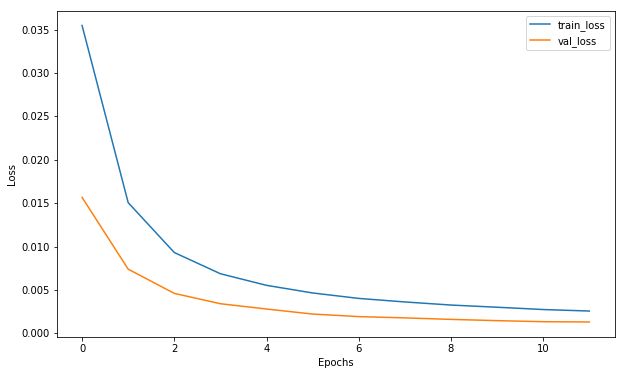

In [24]:
plt.figure(figsize=(10, 6))
plt.plot(train_losses, label="train_loss")
plt.plot(val_losses, label="val_loss")
plt.legend(loc='best')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.show()

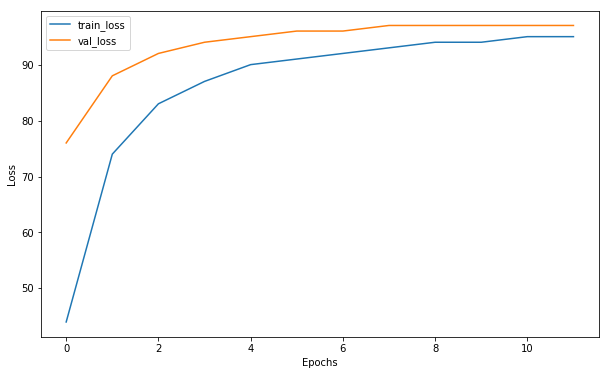

In [25]:
plt.figure(figsize=(10, 6))
plt.plot(train_accuracies, label="train_loss")
plt.plot(val_accuracies, label="val_loss")
plt.legend(loc='best')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.show()

In [26]:
class_correct = list(0. for i in range(n_classes))
class_total = list(0. for i in range(n_classes))
with torch.no_grad():
    for data in val_loader:
        images, labels = data
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        c = (predicted == labels).squeeze()
        for i in range(4):
            label = labels[i]
            class_correct[label] += c[i].item()
            class_total[label] += 1


for i in range(n_classes):
    print('Accuracy of %5s : %2d %%' % (
        classes[i], 100 * class_correct[i] / class_total[i]))

Accuracy of     あ : 100 %
Accuracy of     い : 100 %
Accuracy of     う : 100 %
Accuracy of     え : 100 %
Accuracy of     お : 100 %
Accuracy of     か : 100 %
Accuracy of     き : 100 %
Accuracy of     く : 100 %
Accuracy of     け : 100 %
Accuracy of     こ : 100 %
Accuracy of     さ : 90 %
Accuracy of     し : 100 %
Accuracy of     す : 100 %
Accuracy of     せ : 100 %
Accuracy of     そ : 100 %
Accuracy of     た : 100 %
Accuracy of     ち : 87 %
Accuracy of     つ : 100 %
Accuracy of     て : 100 %
Accuracy of     と : 100 %
Accuracy of     な : 100 %
Accuracy of     に : 100 %
Accuracy of     ぬ : 100 %
Accuracy of     ね : 100 %
Accuracy of     の : 100 %
Accuracy of     は : 100 %
Accuracy of     ひ : 87 %
Accuracy of     ふ : 100 %
Accuracy of     へ : 100 %
Accuracy of     ほ : 100 %
Accuracy of     ま : 100 %
Accuracy of     み : 100 %
Accuracy of     む : 100 %
Accuracy of     め : 100 %
Accuracy of     も : 100 %
Accuracy of     や : 100 %
Accuracy of     ゆ : 100 %
Accuracy of     よ : 100 %
Accuracy of    

In [0]:
def predict(model, val_loader):
    with torch.no_grad():
        outputs = []
    
        for inputs, labels in val_loader:
            
            model.eval()
            outputs.append(model(inputs))
            
    probs = F.softmax(torch.cat(outputs), dim=-1).numpy()
    return probs

In [0]:
probs_ims = predict(model, val_loader)
y_pred = np.argmax(probs_ims,-1)

preds_class = [classes[i] for i in y_pred]

In [29]:
preds_class

['あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'ち',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'も',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'あ',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'ひ',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い',
 'い'

In [31]:
torch.save(model, 'model.pth')

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:256: UserWarning: Couldn't retrieve source code for container of type Model. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
